## Advanced Lane Finding Project

The goals / steps of this project are the following:

* Compute the camera calibration matrix and distortion coefficients given a set of chessboard images.
* Apply a distortion correction to raw images.
* Use color transforms, gradients, etc., to create a thresholded binary image.
* Apply a perspective transform to rectify binary image ("birds-eye view").
* Detect lane pixels and fit to find the lane boundary.
* Determine the curvature of the lane and vehicle position with respect to center.
* Warp the detected lane boundaries back onto the original image.
* Output visual display of the lane boundaries and numerical estimation of lane curvature and vehicle position.

---
### First, I'll compute the camera calibration using chessboard images

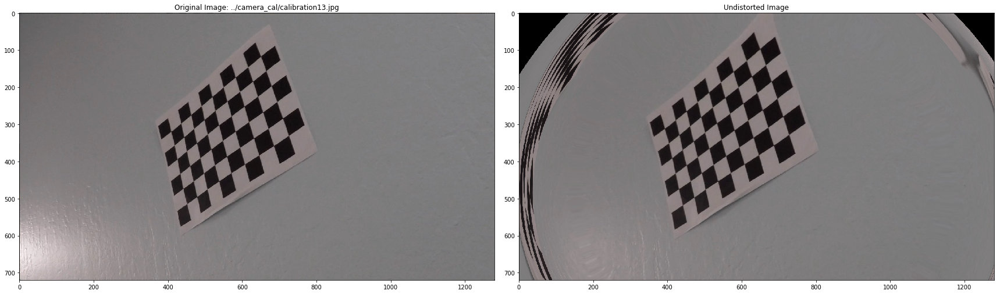

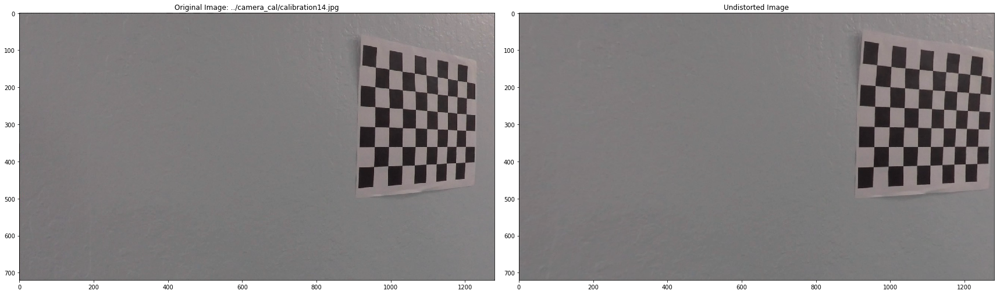

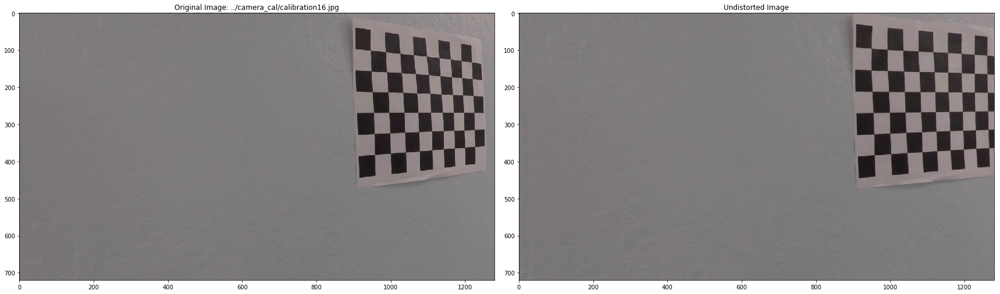

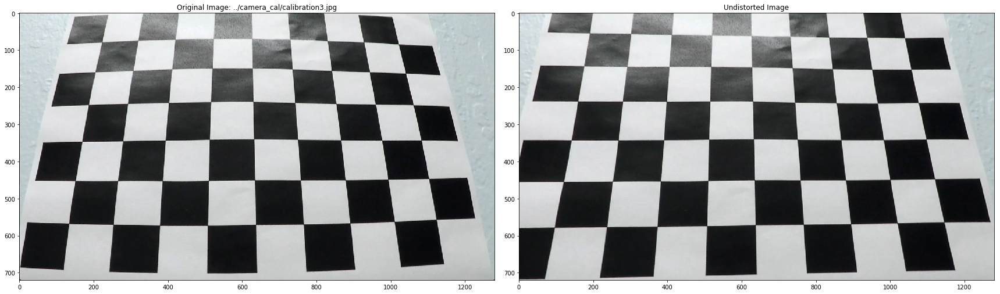

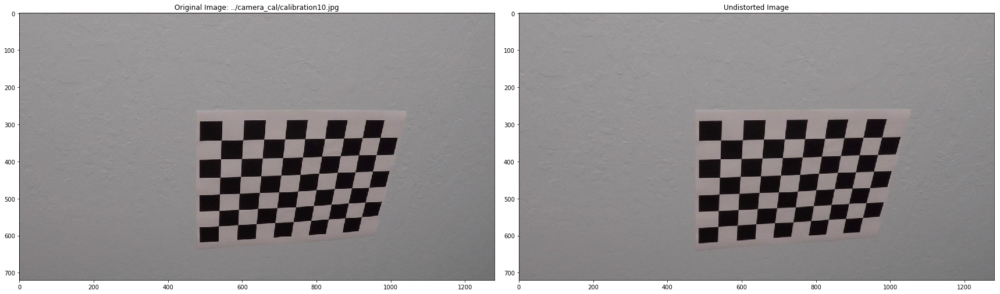

...

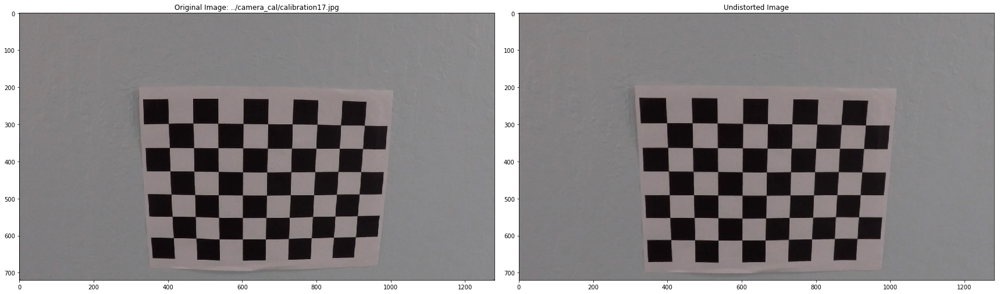

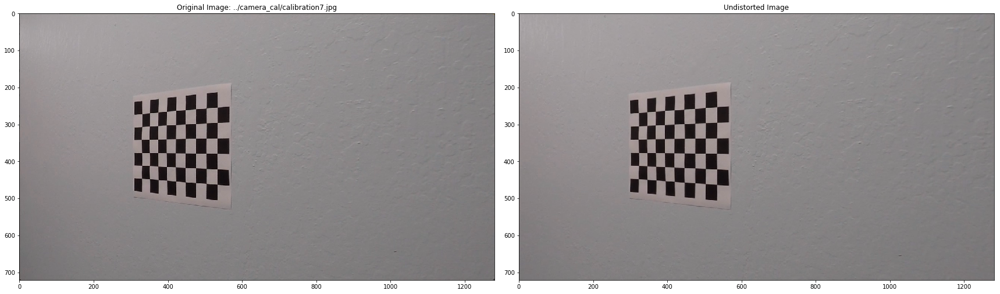

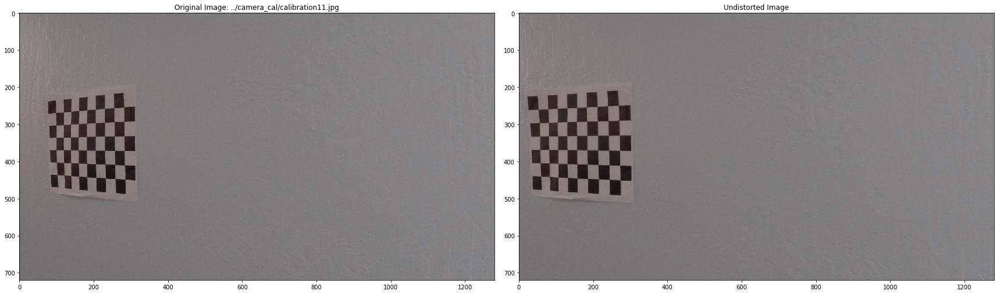

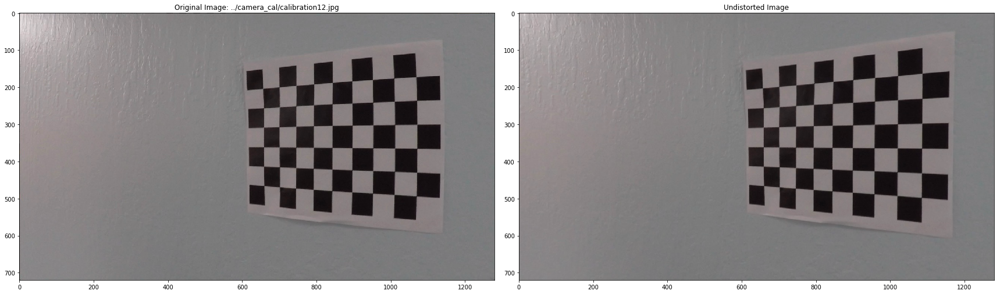

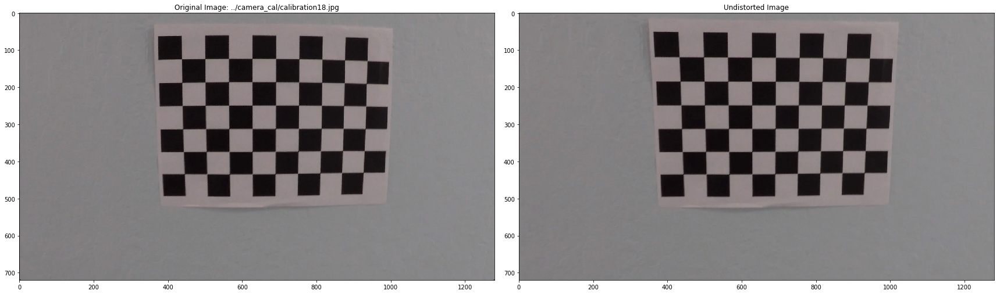

In [1]:
import numpy as np
import cv2
import glob
import matplotlib.pyplot as plt
%matplotlib inline

# prepare object points, like (0,0,0), (1,0,0), (2,0,0) ....,(6,5,0)
objp = np.zeros((6*9,3), np.float32)
objp[:,:2] = np.mgrid[0:9,0:6].T.reshape(-1,2)

# Arrays to store object points and image points from all the images.
objpoints = [] # 3d points in real world space
imgpoints = [] # 2d points in image plane.

# Make a list of calibration images
images = glob.glob('../camera_cal/calibration*.jpg')

def cal_undistort(img, objpoints, imgpoints):
    img = np.copy(img)
    ret, mtx, dist, rvecs, tvecs = cv2.calibrateCamera(objpoints, imgpoints, (img.shape[1], img.shape[0]), None, None)
    dst = cv2.undistort(img, mtx, dist, None, mtx)
    return dst,mtx,dist

l_mtx = []
l_dist = []
# Step through the list and search for chessboard corners
for fname in images:
    img = cv2.imread(fname)
    gray = cv2.cvtColor(img,cv2.COLOR_BGR2GRAY)

    # Find the chessboard corners
    ret, corners = cv2.findChessboardCorners(gray, (9,6),None)

    # If found, add object points, image points
    if ret == True:
        objpoints.append(objp)
        imgpoints.append(corners)

        # Draw and display the corners
#         img = cv2.drawChessboardCorners(np.copy(img), (9,6), corners, ret)
    
        undistorted,mtx,dist = cal_undistort(img, objpoints, imgpoints)
        l_mtx.append(mtx)
        l_dist.append(dist)
        
        f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
        f.tight_layout()
        ax1.imshow(img)
        ax1.set_title('Original Image: ' + fname)
        ax2.imshow(undistorted)
        ax2.set_title('Undistorted Image')
        
        

In [2]:
# import pandas as pd
# df_mtx = pd.DataFrame(np.array(l_mtx).reshape(-1,9))
# # df_mtx
# final_mtx = df_mtx.mean().values.reshape(3,3)

### Apply a distortion correction to raw images.

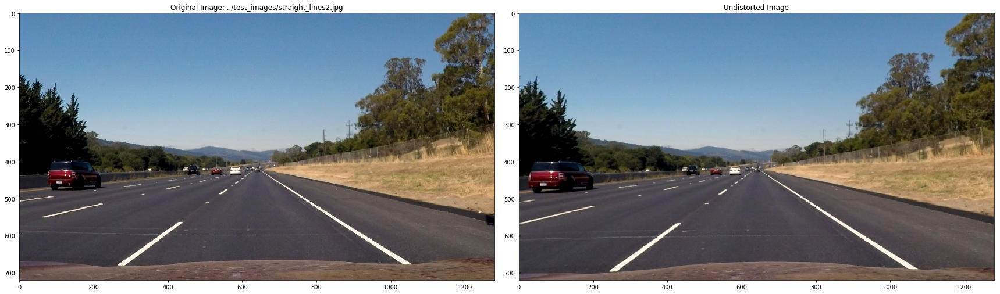

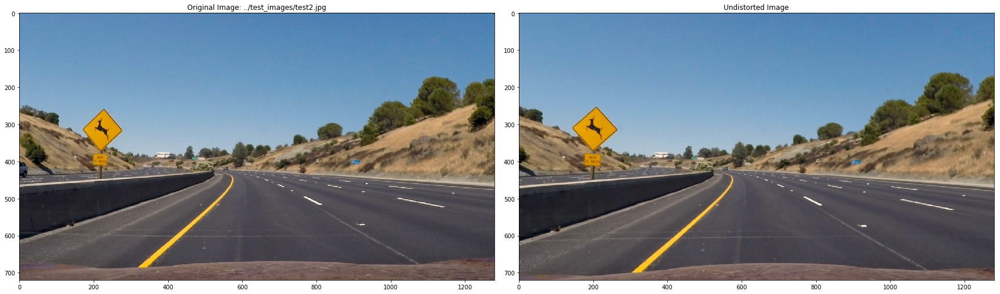

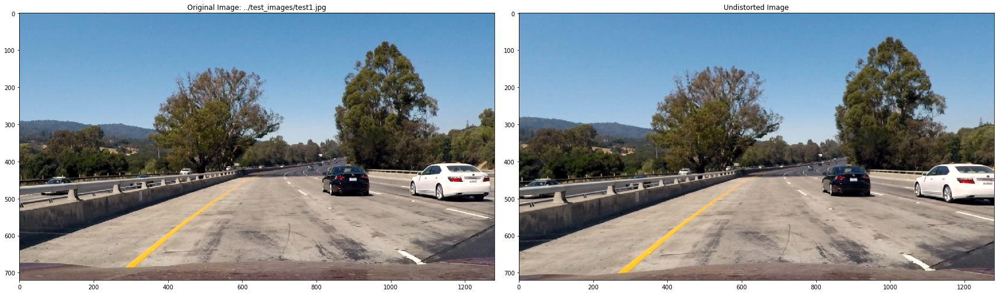

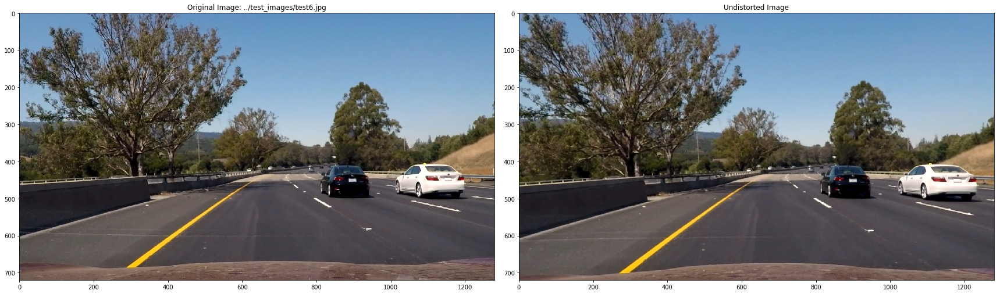

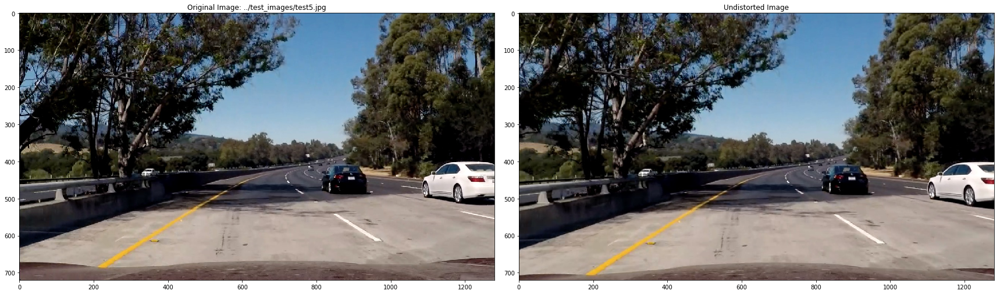

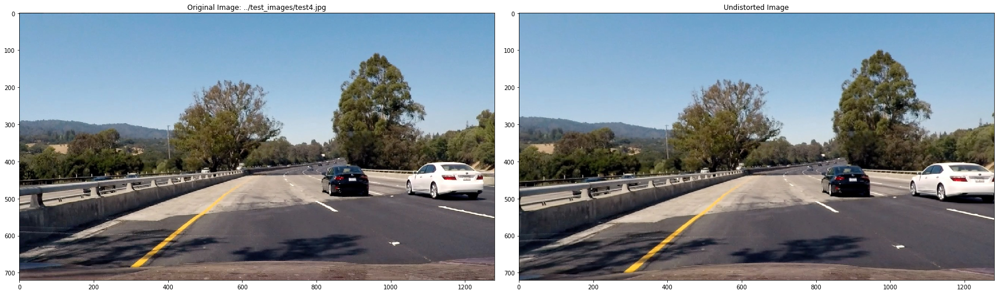

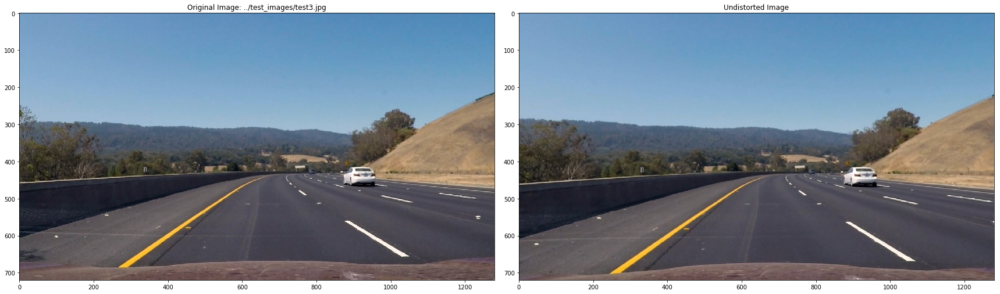

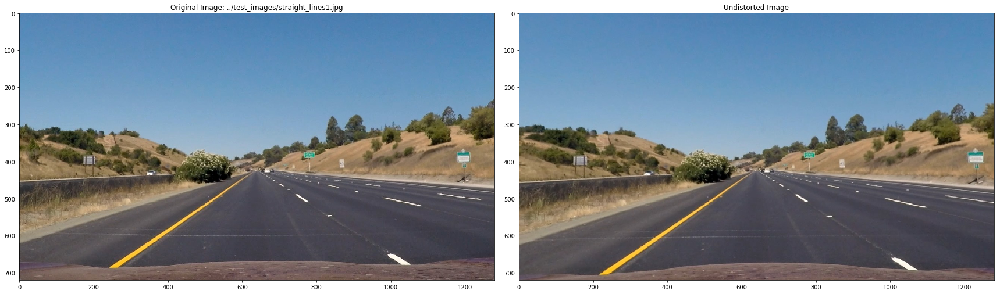

In [3]:
test_images = glob.glob('../test_images/*.jpg')

list_undistorted_imgs = []

for fname in test_images:
    bgr_img = cv2.imread(fname)
    img = cv2.cvtColor(bgr_img, cv2.COLOR_BGR2RGB)

    undistorted,_,_ = cal_undistort(img, objpoints, imgpoints)
    list_undistorted_imgs.append(undistorted)

    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
    f.tight_layout()
    ax1.imshow(img)
    ax1.set_title('Original Image: ' + fname)
    ax2.imshow(undistorted)
    ax2.set_title('Undistorted Image')

### Create a thresholded binary images

Once that undistort all images (as you can see in last cell), I'm going to process each image to select the channels most interesting.
I use de L and S channel (from HLS color) to apply Sobel. Also I get the V channel (from HSV).
At the end, I binarize all channels to get a flat result. 

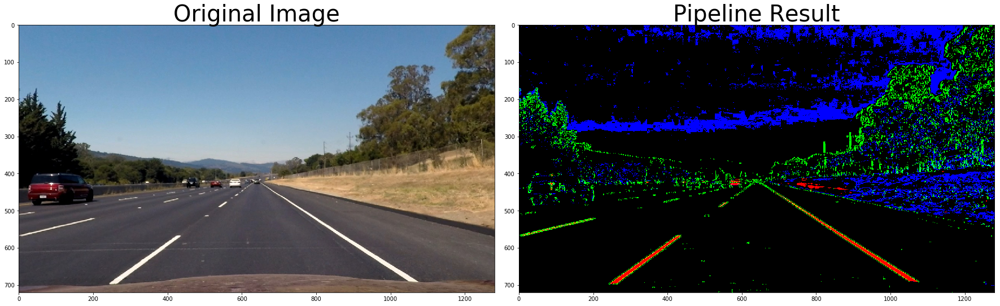

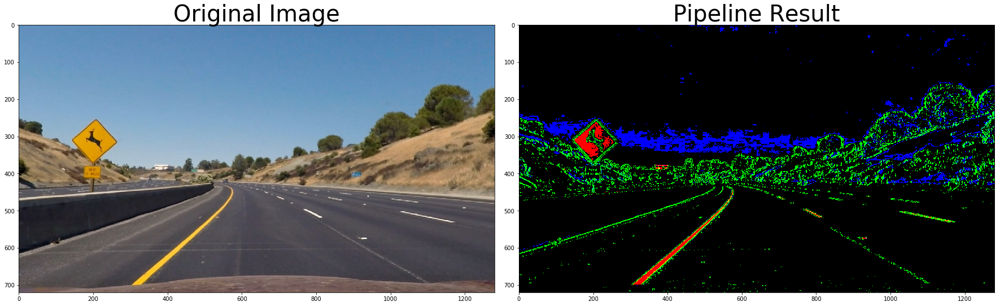

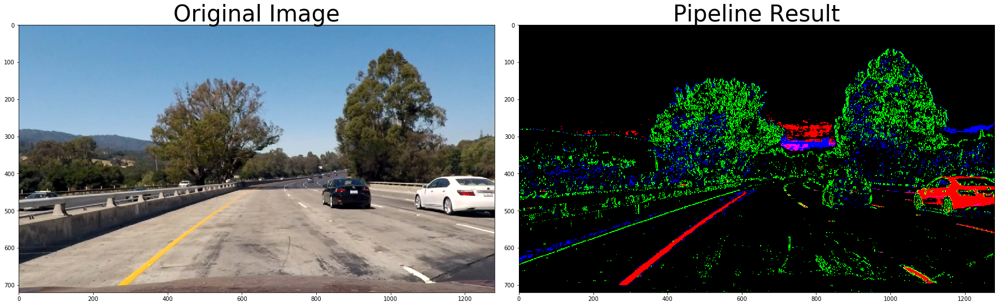

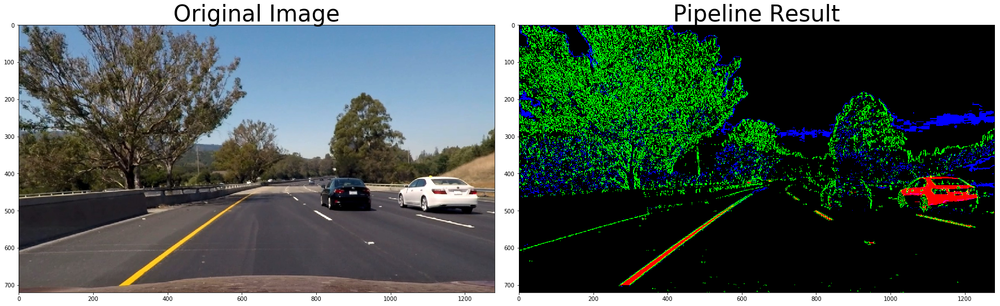

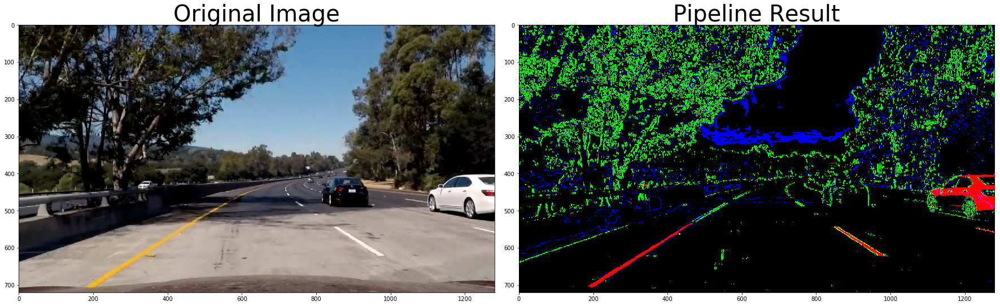

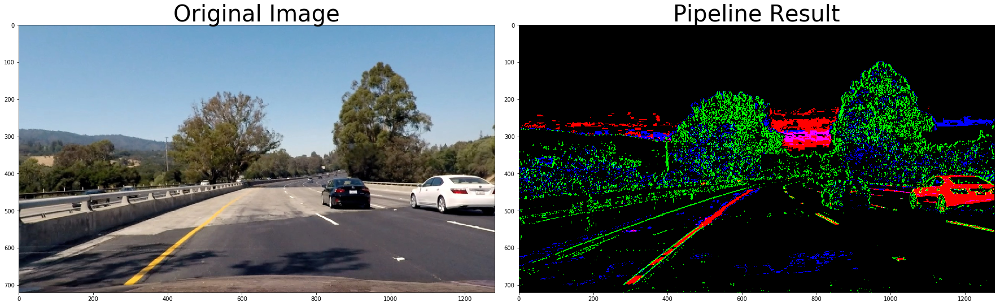

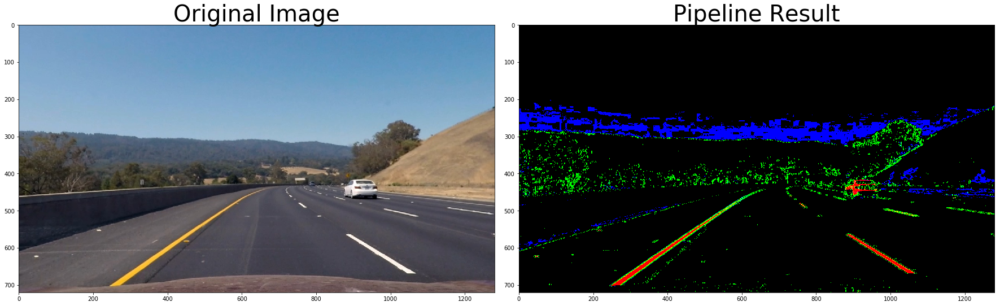

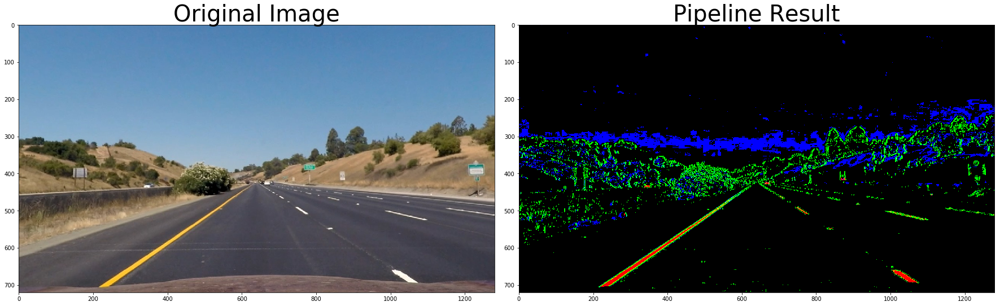

In [4]:
def pipeline(img, s_thresh=(85, 95), sx_thresh=(20, 80), sv_thresh=(225, 255)):
    img = np.copy(img)
    
    # Convert to HLS color space
    hls = cv2.cvtColor(img, cv2.COLOR_RGB2HLS).astype(np.float)
    l_channel = hls[:,:,1]
    s_channel = hls[:,:,2]
    
    # Convert to HSV color space and get the V channel
    hsv = cv2.cvtColor(img, cv2.COLOR_RGB2HSV).astype(np.float)
    v_channel = hsv[:,:,2]
    
    # Sobel x
    sobelx = cv2.Sobel(l_channel, cv2.CV_64F, 1, 0) # Take the derivative in x
    abs_sobelx = np.absolute(sobelx) # Absolute x derivative to accentuate lines away from horizontal
    scaled_sobel = np.uint8(255*abs_sobelx/np.max(abs_sobelx))
    
    # Threshold x gradient
    sxbinary = np.zeros_like(scaled_sobel)
    sxbinary[(scaled_sobel >= sx_thresh[0]) & (scaled_sobel <= sx_thresh[1])] = 1
    
    # Threshold color channel
    s_binary = np.zeros_like(s_channel)
    s_binary[(s_channel >= s_thresh[0]) & (s_channel <= s_thresh[1])] = 1
    
    # Threshold the V channel of the HSV image
    v_binary = np.zeros_like(v_channel)
    v_binary[(v_channel >= sv_thresh[0]) & (v_channel <= sv_thresh[1])] = 1
        
    # Stack each channel
    # Note color_binary[:, :, 0] is all 0s, effectively an all black image. It might
    # be beneficial to replace this channel with something else.
    color_binary = np.dstack((v_binary, sxbinary, s_binary)) 
    
    sum_binary = np.zeros_like(sxbinary)
    sum_binary[(v_binary == 1) | (sxbinary == 1) | (s_binary == 1)] = 1
    
    return color_binary, sum_binary
    
for image in list_undistorted_imgs:
    result,_ = pipeline(image)
    # Plot the result
    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
    f.tight_layout()

    ax1.imshow(image)
    ax1.set_title('Original Image', fontsize=40)

    ax2.imshow(result)
    ax2.set_title('Pipeline Result', fontsize=40)
    plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)

### Birds-eye view

I have thresholded and binarized the images, so I can warp them and get the bird-eye

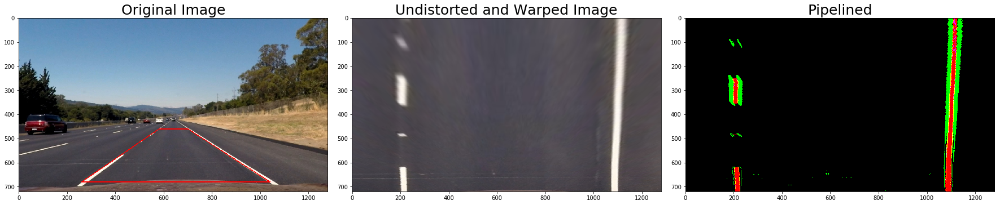

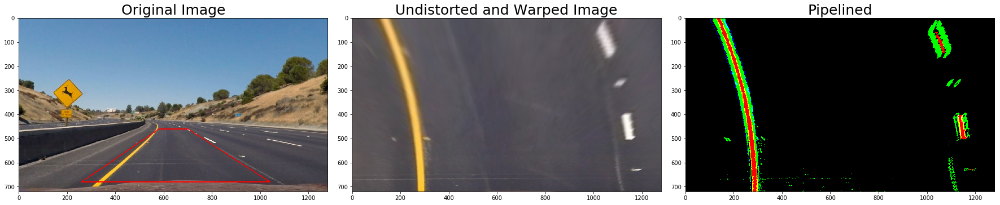

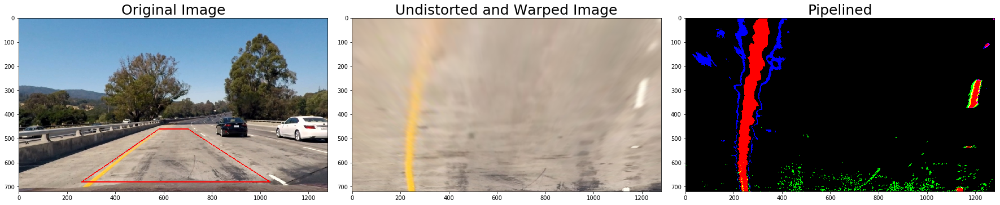

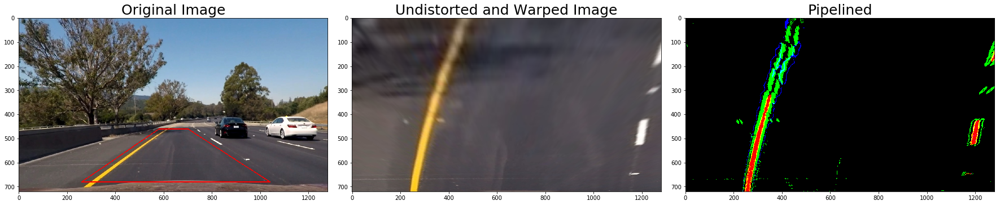

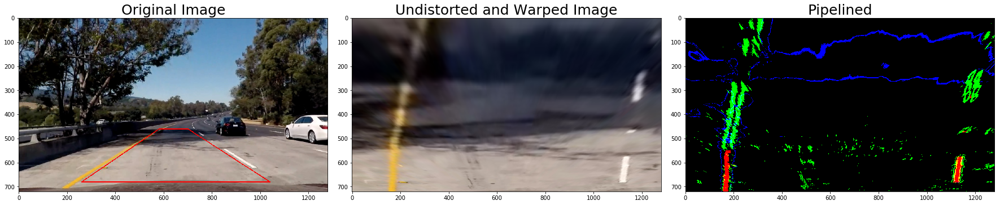

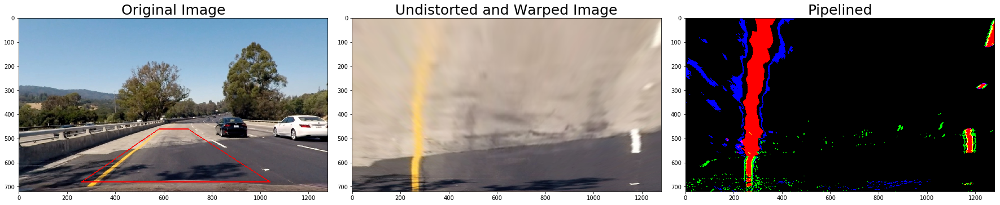

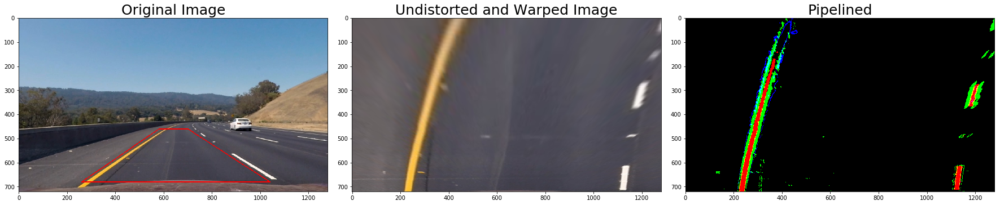

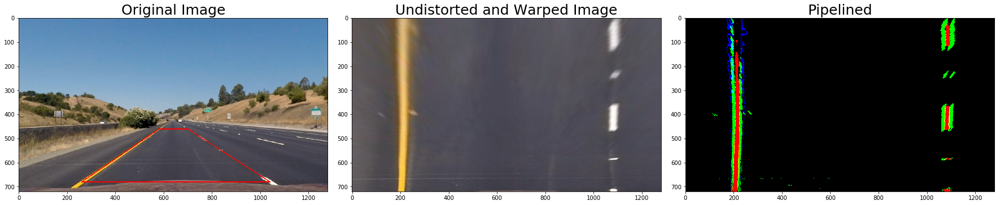

In [5]:
src = np.float32(
[[580, 460],
 [700, 460],
 [1040, 680],
 [260, 680]])

dst = np.float32(
[[200, 0],
 [1080, 0],
 [1080,720],
 [200,720]])

def warp_img(img):
    img = np.copy(img)
    
    width = img.shape[1]
    height = img.shape[0]
    img_size = (width, height)
    
    M = cv2.getPerspectiveTransform(src, dst)
    # Warp the image using OpenCV warpPerspective()
    warped = cv2.warpPerspective(img, M, img_size)
    
    #Draw the polygon
    pts = np.copy(src).astype(int).reshape((-1,1,2))
    new_img = cv2.polylines(np.copy(img),[pts],True,(255,0,0), 2)     
    
    return warped, new_img

pipelined_bw_warped_undistorted_imgs = []
pipelined_warped_undistorted_imgs = []
warped_imgs = []

for image in list_undistorted_imgs:

    warped_img, polygon_img = warp_img(image)
    warped_imgs.append(warped_img)

    f, (ax1, ax2, ax3) = plt.subplots(1, 3, figsize=(24, 9))
    f.tight_layout()

    ax1.imshow(polygon_img)
    ax1.set_title('Original Image', fontsize=25)

    ax2.imshow(warped_img)
    ax2.set_title('Undistorted and Warped Image', fontsize=25)
    plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)
    
    pipelined_tmp, pipelined_bw_tmp  = pipeline(warped_img)
    pipelined_warped_undistorted_imgs.append(pipelined_tmp)
    pipelined_bw_warped_undistorted_imgs.append(pipelined_bw_tmp)
    ax3.imshow(pipelined_tmp)
    ax3.set_title('Pipelined', fontsize=25)
    plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)



### Detect lane pixels and fit to find the lane boundary.

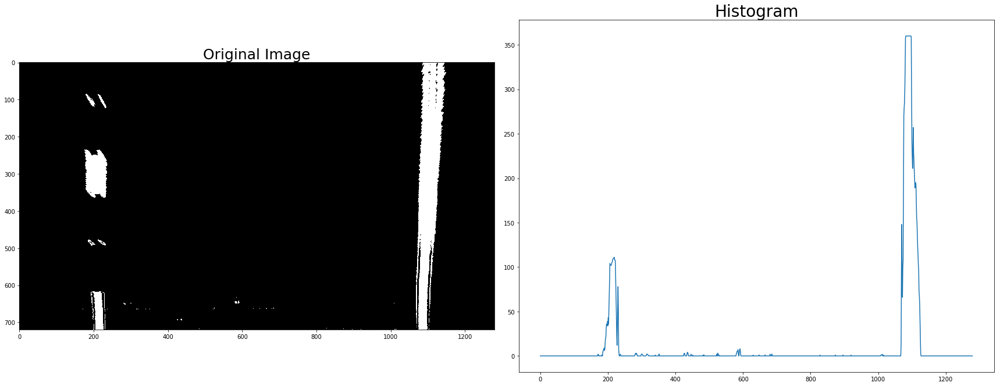

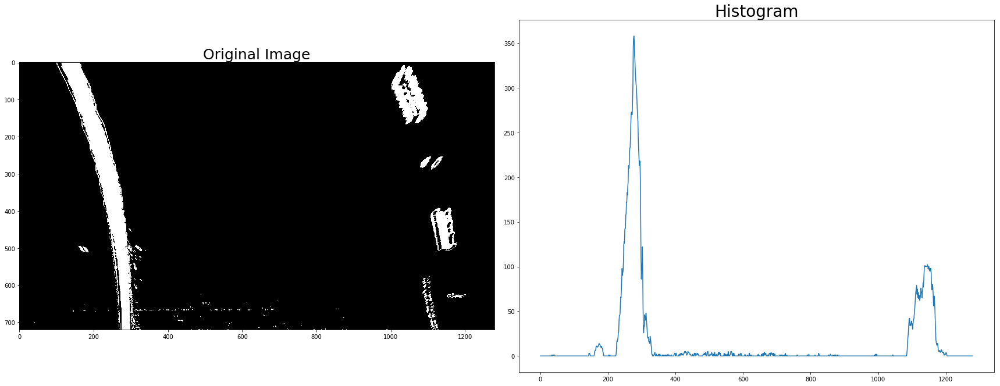

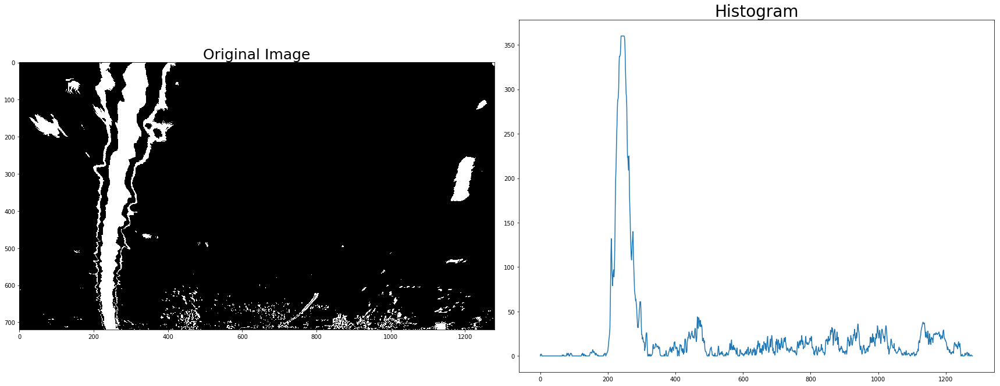

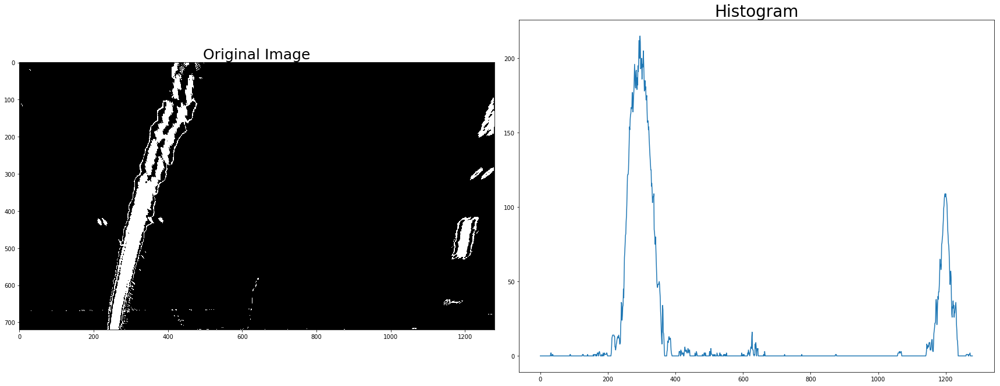

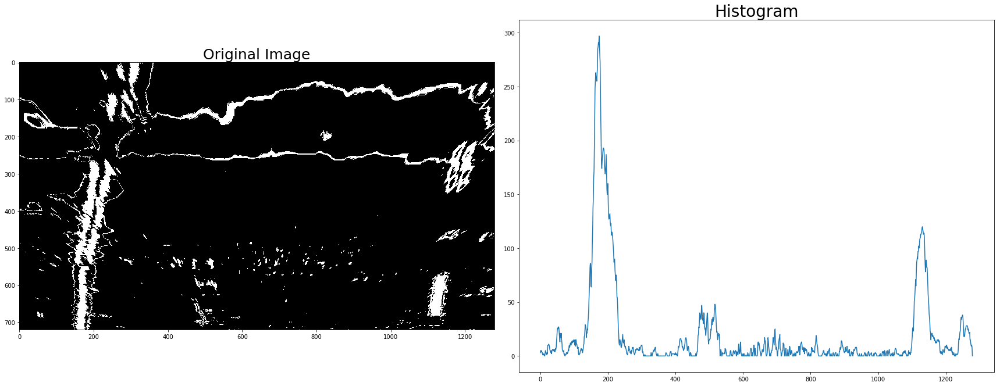

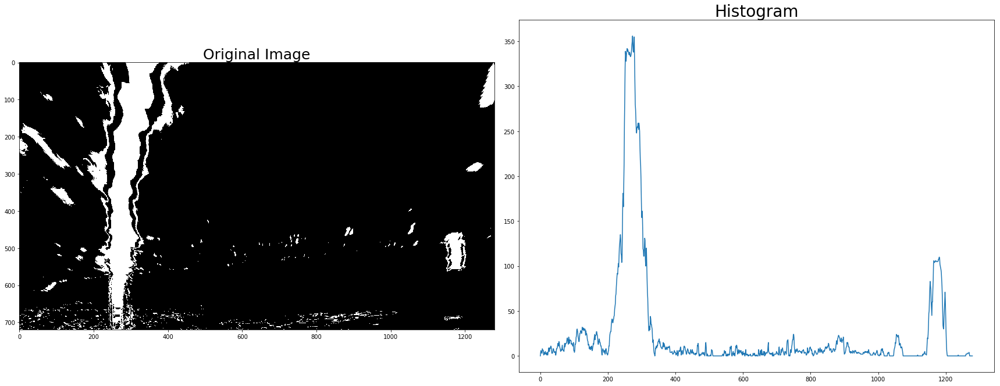

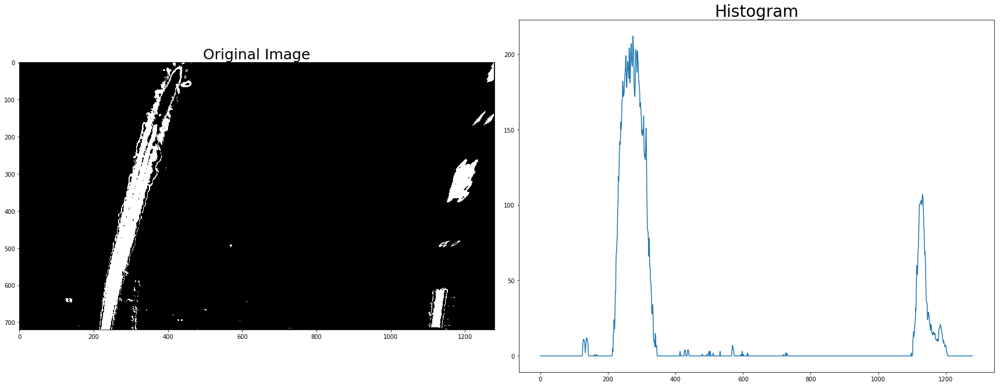

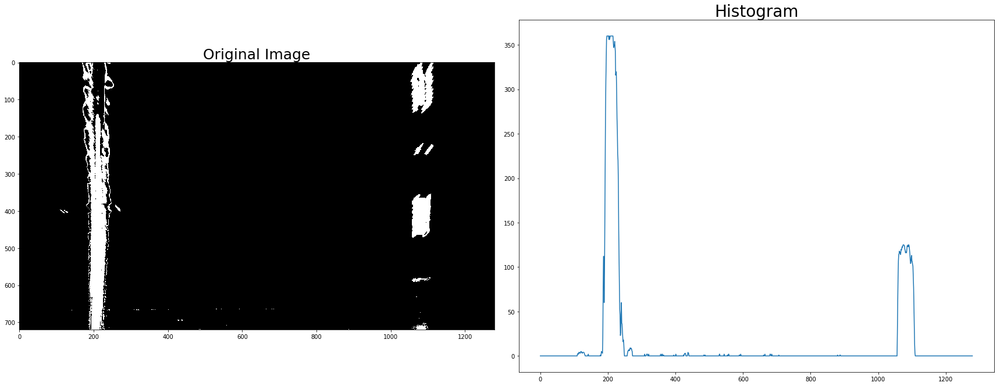

In [6]:
for image in pipelined_bw_warped_undistorted_imgs:
    
    histogram = np.sum(image[image.shape[0]//2:,:], axis=0)
    
    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
    f.tight_layout()

    ax1.imshow(image,cmap='gray')
    ax1.set_title('Original Image', fontsize=25)

    ax2.plot(histogram)
    ax2.set_title('Histogram', fontsize=28)

### Sliding Windows Search

Thanks to binarization and warped, as you can see in histogram, the detect lanes is much more easy. So I use the next functions tho find them (with sliding window strategy) and measure the curves

In [7]:
def finding_lines(binary_warped):
    # Assuming you have created a warped binary image called "binary_warped"
    # Take a histogram of the bottom half of the image
    histogram = np.sum(binary_warped[binary_warped.shape[0]/2:,:], axis=0)
    # Create an output image to draw on and  visualize the result
    out_img = np.dstack((binary_warped, binary_warped, binary_warped))*255
    # Find the peak of the left and right halves of the histogram
    # These will be the starting point for the left and right lines
    midpoint = np.int(histogram.shape[0]/2)
    leftx_base = np.argmax(histogram[:midpoint])
    rightx_base = np.argmax(histogram[midpoint:]) + midpoint

    # Choose the number of sliding windows
    nwindows = 9
    # Set height of windows
    window_height = np.int(binary_warped.shape[0]/nwindows)
    # Identify the x and y positions of all nonzero pixels in the image
    nonzero = binary_warped.nonzero()
    nonzeroy = np.array(nonzero[0])
    nonzerox = np.array(nonzero[1])
    # Current positions to be updated for each window
    leftx_current = leftx_base
    rightx_current = rightx_base
    # Set the width of the windows +/- margin
    margin = 100
    # Set minimum number of pixels found to recenter window
    minpix = 50
    # Create empty lists to receive left and right lane pixel indices
    left_lane_inds = []
    right_lane_inds = []

    # Step through the windows one by one
    for window in range(nwindows):
        # Identify window boundaries in x and y (and right and left)
        win_y_low = binary_warped.shape[0] - (window+1)*window_height
        win_y_high = binary_warped.shape[0] - window*window_height
        win_xleft_low = leftx_current - margin
        win_xleft_high = leftx_current + margin
        win_xright_low = rightx_current - margin
        win_xright_high = rightx_current + margin
        # Draw the windows on the visualization image
        cv2.rectangle(out_img,(win_xleft_low,win_y_low),(win_xleft_high,win_y_high),
        (0,255,0), 2) 
        cv2.rectangle(out_img,(win_xright_low,win_y_low),(win_xright_high,win_y_high),
        (0,255,0), 2) 
        # Identify the nonzero pixels in x and y within the window
        good_left_inds = ((nonzeroy >= win_y_low) & (nonzeroy < win_y_high) & 
        (nonzerox >= win_xleft_low) &  (nonzerox < win_xleft_high)).nonzero()[0]
        good_right_inds = ((nonzeroy >= win_y_low) & (nonzeroy < win_y_high) & 
        (nonzerox >= win_xright_low) &  (nonzerox < win_xright_high)).nonzero()[0]
        # Append these indices to the lists
        left_lane_inds.append(good_left_inds)
        right_lane_inds.append(good_right_inds)
        # If you found > minpix pixels, recenter next window on their mean position
        if len(good_left_inds) > minpix:
            leftx_current = np.int(np.mean(nonzerox[good_left_inds]))
        if len(good_right_inds) > minpix:        
            rightx_current = np.int(np.mean(nonzerox[good_right_inds]))

    # Concatenate the arrays of indices
    left_lane_inds = np.concatenate(left_lane_inds)
    right_lane_inds = np.concatenate(right_lane_inds)

    # Extract left and right line pixel positions
    leftx = nonzerox[left_lane_inds]
    lefty = nonzeroy[left_lane_inds] 
    rightx = nonzerox[right_lane_inds]
    righty = nonzeroy[right_lane_inds] 

    # Fit a second order polynomial to each
    left_fit = np.polyfit(lefty, leftx, 2)
    right_fit = np.polyfit(righty, rightx, 2)
    
    out_img[nonzeroy[left_lane_inds], nonzerox[left_lane_inds]] = [255, 0, 0]
    out_img[nonzeroy[right_lane_inds], nonzerox[right_lane_inds]] = [0, 0, 255]
    
    ploty = np.linspace(0, image.shape[0]-1, image.shape[0])
    left_fitx = left_fit[0]*ploty**2 + left_fit[1]*ploty + left_fit[2]
    right_fitx = right_fit[0]*ploty**2 + right_fit[1]*ploty + right_fit[2]
    
    return left_fit, right_fit, out_img, left_fitx, right_fitx, ploty


In [8]:
def skip_sliding_window(binary_warped, left_fit, right_fit):
    # Assume you now have a new warped binary image 
    # from the next frame of video (also called "binary_warped")
    # It's now much easier to find line pixels!
    nonzero = binary_warped.nonzero()
    nonzeroy = np.array(nonzero[0])
    nonzerox = np.array(nonzero[1])
    margin = 100
    left_lane_inds = ((nonzerox > (left_fit[0]*(nonzeroy**2) + left_fit[1]*nonzeroy + 
    left_fit[2] - margin)) & (nonzerox < (left_fit[0]*(nonzeroy**2) + 
    left_fit[1]*nonzeroy + left_fit[2] + margin))) 

    right_lane_inds = ((nonzerox > (right_fit[0]*(nonzeroy**2) + right_fit[1]*nonzeroy + 
    right_fit[2] - margin)) & (nonzerox < (right_fit[0]*(nonzeroy**2) + 
    right_fit[1]*nonzeroy + right_fit[2] + margin)))  

    # Again, extract left and right line pixel positions
    leftx = nonzerox[left_lane_inds]
    lefty = nonzeroy[left_lane_inds] 
    rightx = nonzerox[right_lane_inds]
    righty = nonzeroy[right_lane_inds]
    # Fit a second order polynomial to each
    left_fit = np.polyfit(lefty, leftx, 2)
    right_fit = np.polyfit(righty, rightx, 2)
    # Generate x and y values for plotting
    ploty = np.linspace(0, binary_warped.shape[0]-1, binary_warped.shape[0] )
    left_fitx = left_fit[0]*ploty**2 + left_fit[1]*ploty + left_fit[2]
    right_fitx = right_fit[0]*ploty**2 + right_fit[1]*ploty + right_fit[2]
    
    out_img = np.dstack((binary_warped, binary_warped, binary_warped))*255
    window_img = np.zeros_like(out_img)
    # Color in left and right line pixels
    out_img[nonzeroy[left_lane_inds], nonzerox[left_lane_inds]] = [255, 0, 0]
    out_img[nonzeroy[right_lane_inds], nonzerox[right_lane_inds]] = [0, 0, 255]

    # Generate a polygon to illustrate the search window area
    # And recast the x and y points into usable format for cv2.fillPoly()
    left_line_window1 = np.array([np.transpose(np.vstack([left_fitx-margin, ploty]))])
    left_line_window2 = np.array([np.flipud(np.transpose(np.vstack([left_fitx+margin, 
                                  ploty])))])
    left_line_pts = np.hstack((left_line_window1, left_line_window2))
    right_line_window1 = np.array([np.transpose(np.vstack([right_fitx-margin, ploty]))])
    right_line_window2 = np.array([np.flipud(np.transpose(np.vstack([right_fitx+margin, 
                                  ploty])))])
    right_line_pts = np.hstack((right_line_window1, right_line_window2))

    # Draw the lane onto the warped blank image
    cv2.fillPoly(window_img, np.int_([left_line_pts]), (0,255, 0))
    cv2.fillPoly(window_img, np.int_([right_line_pts]), (0,255, 0))
    result = cv2.addWeighted(out_img, 1, window_img, 0.3, 0)
    
    return left_fitx, right_fitx, result
    

### Determine the curvature of the lane 

In [9]:
ym_per_pix = 30/720 # meters per pixel in y dimension
xm_per_pix = 3.7/700 # meters per pixel in x dimension

def curvature_measure(left_fitx, right_fitx, ploty):
    y_eval = np.max(ploty)
    # Fit new polynomials to x,y in world space
    left_fit_cr = np.polyfit(ploty*ym_per_pix, left_fitx*xm_per_pix, 2)
    right_fit_cr = np.polyfit(ploty*ym_per_pix, right_fitx*xm_per_pix, 2)
    # Calculate the new radio of curvature
    left_curverad = ((1 + (2*left_fit_cr[0]*y_eval*ym_per_pix + left_fit_cr[1])**2)**1.5) / np.absolute(2*left_fit_cr[0])
    right_curverad = ((1 + (2*right_fit_cr[0]*y_eval*ym_per_pix + right_fit_cr[1])**2)**1.5) / np.absolute(2*right_fit_cr[0])

    return left_curverad, right_curverad

### Process all

In [10]:
def make_final_image(left_fitx, right_fitx, left_curverad, right_curverad, binary_warped, undistorted, ploty):

    left_fit_cr = np.polyfit(ploty*ym_per_pix, left_fitx*xm_per_pix, 2)
    right_fit_cr = np.polyfit(ploty*ym_per_pix, right_fitx*xm_per_pix, 2)
    
    #vehicle position with respect to center.
    car_pos = ((
                (left_fitx[0] + right_fitx[0]) / 2) - (binary_warped.shape[1] / 2)
                ) * xm_per_pix

    # Create an image to draw the lines on
    warp_zero = np.zeros_like(binary_warped).astype(np.uint8)
    color_warp = np.dstack((warp_zero, warp_zero, warp_zero))

    # Recast the x and y points into usable format for cv2.fillPoly()
    pts_left = np.array([np.transpose(np.vstack([left_fitx, ploty]))])
    pts_right = np.array([np.flipud(np.transpose(np.vstack([right_fitx, ploty])))])
    pts = np.hstack((pts_left, pts_right))

    # Draw the lane onto the warped blank image
    cv2.fillPoly(color_warp, np.int_([pts]), (0,255, 0))
    
    Minv = cv2.getPerspectiveTransform(dst, src)
    # Warp the blank back to original image space using inverse perspective matrix (Minv)
    newwarp = cv2.warpPerspective(color_warp, Minv, (img.shape[1], img.shape[0]))
    # Combine the result with the original image
    result = cv2.addWeighted(undistorted, 1, newwarp, 0.3, 0)

    font = cv2.FONT_HERSHEY_SIMPLEX
    text = "Left: {:.2f} m".format(left_curverad)
    cv2.putText(result, text, (50,50), font, 2, (255,255,255), 3)
    text = "Right: {:.2f} m".format(right_curverad)
    cv2.putText(result, text, (50,125), font, 2, (255,255,255), 3)
    text = "Offset from center: {:.2f} m".format(car_pos)
    cv2.putText(result, text, (50,200), font, 2, (255,255,255), 3)

    return result

/home/adrian/anaconda2/envs/py3_lane/lib/python3.5/site-packages/ipykernel_launcher.py:4: VisibleDeprecationWarning: using a non-integer number instead of an integer will result in an error in the future
  after removing the cwd from sys.path.


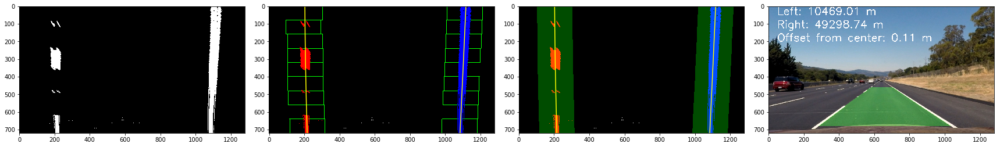

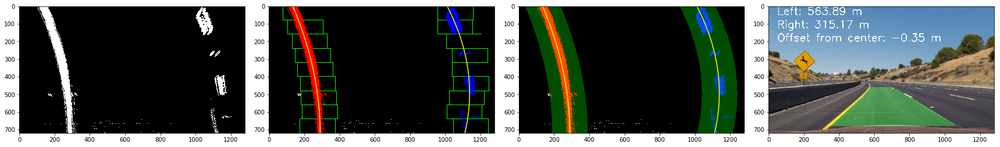

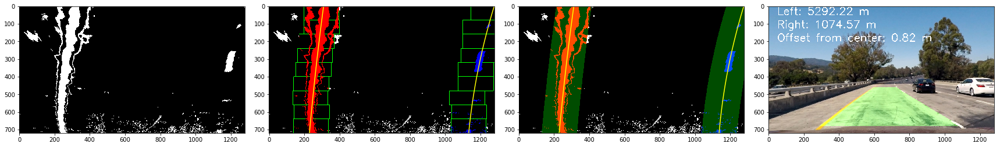

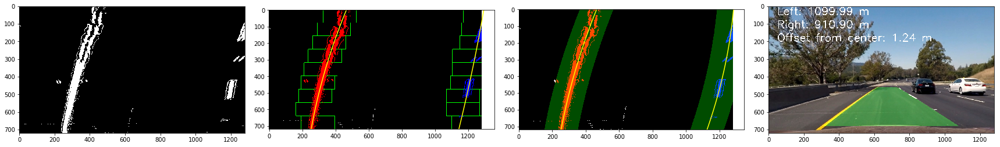

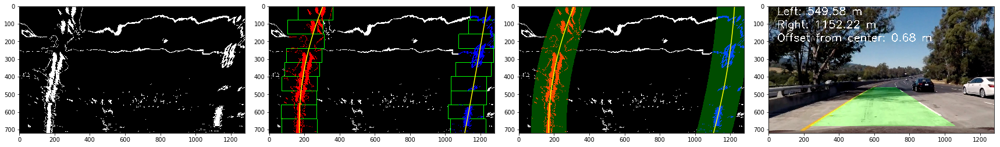

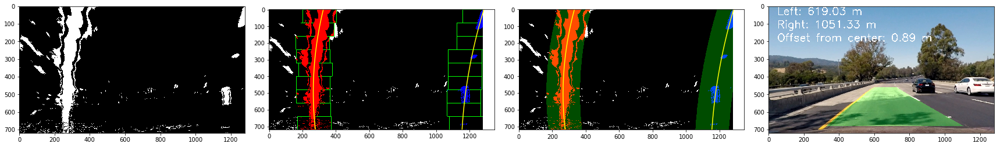

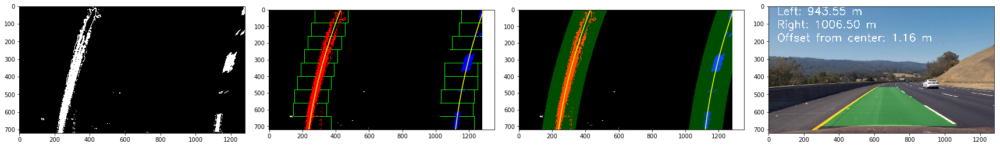

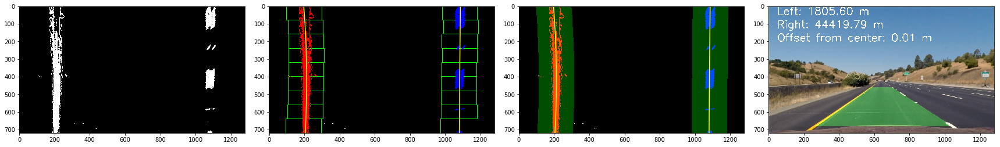

In [11]:
for warped_bw, undistorted_img,warped_img in zip(pipelined_bw_warped_undistorted_imgs,list_undistorted_imgs,warped_imgs) :
    left_fit, right_fit, out_img, left_fitx, right_fitx, ploty = finding_lines(warped_bw)
    
    f, (ax1, ax2, ax3, ax4) = plt.subplots(1, 4, figsize=(24, 9))
    f.tight_layout()
    ax1.imshow(warped_bw, cmap='gray')
    
    ax2.imshow(out_img)
    ax2.plot(left_fitx, ploty, color='yellow')
    ax2.plot(right_fitx, ploty, color='yellow')
    
    left_fitx, right_fitx, result = skip_sliding_window(warped_bw, left_fit, right_fit)
    
    ax3.imshow(result)
    ax3.plot(left_fitx, ploty, color='yellow')
    ax3.plot(right_fitx, ploty, color='yellow')
    
    left_curverad, right_curverad = curvature_measure(left_fitx, right_fitx, ploty)
    final_image = make_final_image(left_fitx, right_fitx, left_curverad, right_curverad, warped_bw, undistorted_img, ploty)
    ax4.imshow(final_image)
    


## Make Video with all pipeline

In the next function (process_image) I merge all implemented strategies. I pass this function to each frames to make the final video

/home/adrian/anaconda2/envs/py3_lane/lib/python3.5/site-packages/ipykernel_launcher.py:4: VisibleDeprecationWarning: using a non-integer number instead of an integer will result in an error in the future
  after removing the cwd from sys.path.


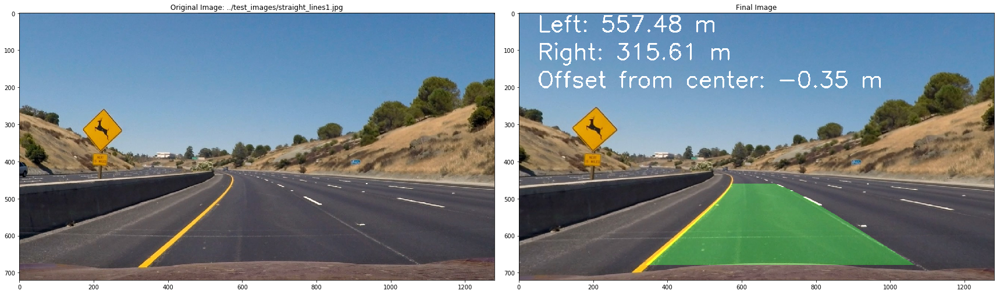

In [12]:
def process_image(img):
    undistorted,_,_ = cal_undistort(img, objpoints, imgpoints)
    warped_img, _ = warp_img(undistorted)
    _, warped_bw  = pipeline(warped_img)
    left_fit, right_fit, out_img, left_fitx, right_fitx, ploty = finding_lines(warped_bw)
#     left_fitx, right_fitx, result = skip_sliding_window(warped_bw, left_fit, right_fit)
    left_curverad, right_curverad = curvature_measure(left_fitx, right_fitx, ploty)
    final_image = make_final_image(left_fitx, right_fitx, left_curverad, right_curverad, warped_bw, undistorted, ploty)
    return final_image

img = cv2.cvtColor(cv2.imread("/home/adrian/carnd/CarND-Advanced-Lane-Lines/test_images/test2.jpg"), cv2.COLOR_BGR2RGB)
f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
f.tight_layout()
ax1.imshow(img)
ax1.set_title('Original Image: ' + fname)

ax2.imshow(process_image(img))
ax2.set_title('Final Image')


In [13]:
from moviepy.editor import VideoFileClip
from IPython.display import HTML

project_video_output = ("../project_final_video.mp4")
clip1 = VideoFileClip("../project_video.mp4")
white_clip = clip1.fl_image(process_image)
%time white_clip.write_videofile(project_video_output, audio=False)

[MoviePy] >>>> Building video ../project_final_video.mp4
[MoviePy] Writing video ../project_final_video.mp4


100%|█████████▉| 1260/1261 [14:05<00:00,  1.51it/s]


[MoviePy] Done.
[MoviePy] >>>> Video ready: ../project_final_video.mp4 

CPU times: user 47min 54s, sys: 20.6 s, total: 48min 15s
Wall time: 14min 5s


link to video: https://www.youtube.com/watch?v=WpbQkHkdLx8

### Discussion

It was a very challenge project. I reach good results in ideal conditions (e.g. project_video.mp4). However, in hard conditions (in night, too much contrast/differents lights etc), It seems that this pipeline will fail, so it will be necessary more steps and filters, even more cameras and new sensors. 

Another problem it's with real-time, because it took 14min to process a 1min video, so this code is not optimized and ready to production. Of course this is not the goal, but it is interesting to comment.